## DEV NOTEBOOK
*This is the notebook used for the initial development of the "library"*

In [107]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import gridspec
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer
from tqdm import tqdm

### Load the image as numpy array

The image shape is (3024, 4032, 3)


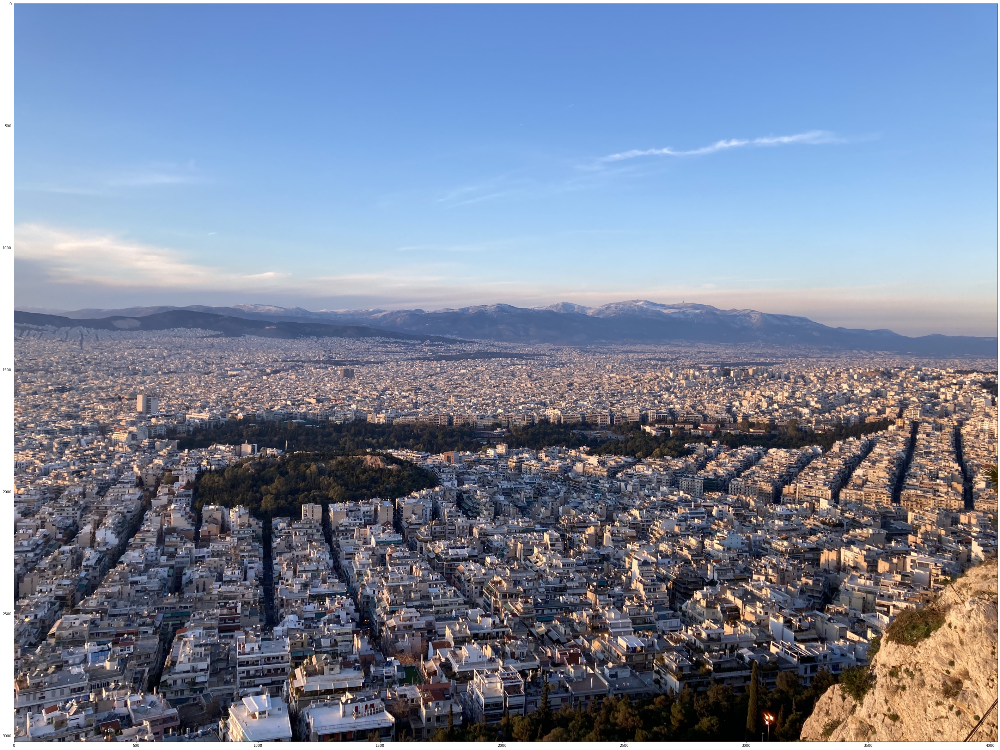

In [108]:
IMAGE_PATH = "city.jpg"
img = plt.imread(IMAGE_PATH)
img_shape = img.shape
num_cols = img_shape[2]
print(f"The image shape is {img.shape}")

aspect_ratio = img_shape[1]/img_shape[0]
figsize = (50,50*aspect_ratio)

# plot the image
plt.figure(figsize=figsize)
plt.imshow(img)
plt.show()

### Convert the image to a matrix
*RGB as columns and pixel positions as rows*

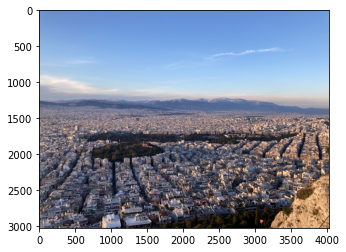

In [109]:
rimg = img.reshape(-1,3)
# check that reshape gives the same image
plt.imshow(rimg.reshape(img_shape))

### Some basic EDA

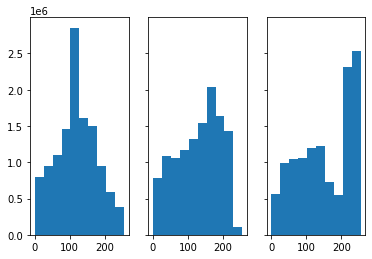

In [110]:
# check the distribution of the colors RGB
fig, axs = plt.subplots(1,num_cols, sharex=True, sharey=True)
for col in range(num_cols):
    axs[col].hist(rimg[:, col])
    
plt.show()

### Transformations 

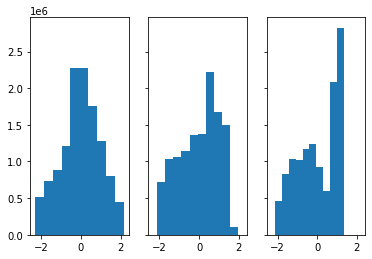

In [111]:
scaler = PowerTransformer()
X_new = scaler.fit_transform(rimg)
fig, axs = plt.subplots(1,num_cols, sharex=True, sharey=True)
for col in range(num_cols):
    axs[col].hist(X_new[:, col])
    
plt.show()

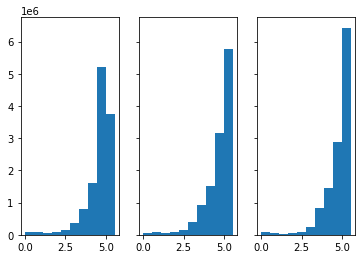

In [112]:
X_new = np.log(rimg + np.ones(rimg.shape))
fig, axs = plt.subplots(1,num_cols, sharex=True, sharey=True)
for col in range(num_cols):
    axs[col].hist(X_new[:, col])
    
plt.show()

### K-means - 1 pass

In [113]:
# Fit the algorithm and assign each pixel to a cluster
N_CLUSTERS = 5
kmeans = KMeans(n_clusters=N_CLUSTERS, algorithm='full')
X = kmeans.fit_predict(rimg)
# round clusters to the nearest integer (RGB compatible)
clusters = np.rint(kmeans.cluster_centers_)

In [114]:
# Map the pixel to the cluster centre
new_img = np.array([clusters[pixel] for pixel in X], dtype=int)
# reshape the image to the orignal shape
new_img = new_img.reshape(img_shape)

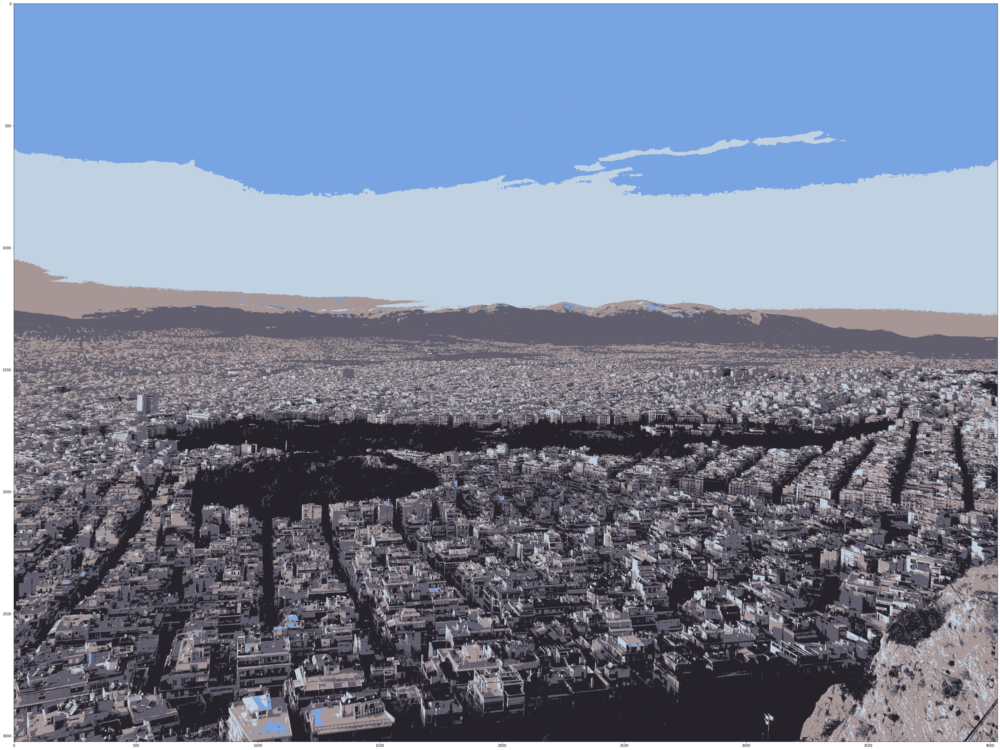

In [115]:
# plot the new image
plt.figure(figsize=figsize)
plt.imshow(new_img)
plt.show()

### K-means - function that returns the changed array

In [101]:
def load_image(image_path, reshape=True):
    """
    load image and reshape to number-of-pixels X 3 matrix
    """
    img = plt.imread(image_path)
    img_shape = img.shape
    if reshape:
        img = img.reshape(-1,img_shape[-1])
        
    return img, img_shape

def image_kmeans(img, img_shape, n_clusters=8, show_image=False):
    """
    single image k-means
    """
    kmeans = KMeans(n_clusters=n_clusters, algorithm='full')
    X = kmeans.fit_predict(img)
    # round clusters to the nearest integer (RGB compatible)
    clusters = np.rint(kmeans.cluster_centers_)
    img = np.array([clusters[pixel] for pixel in X], dtype=int)
    img = img.reshape(img_shape)
    
    if show_image:
        plt.imshow(img)
        
    return img


def fibonacci():
    """ 
    fibonacci sequence generator
    """
    a = 1
    b = 2
    while True:
        yield a
        a, b = b, a + b

def image_kmeans_mossaic(image_path, 
                         width=4, height=3, 
                         progression="arithmetic",
                         step=1, 
                         save_image_path=None, 
                         show_image=True
                        ):
    """
    Image k-means for different values of K.
    """
    # check types and create the iterable to loop over
    N_clusters = height * width
    
    img, img_shape = load_image(image_path, reshape=True)
    aspect_ratio = (img_shape[0]*height)/(img_shape[1]*width)
    figsize = (50,50*aspect_ratio)
    fig, axs = plt.subplots(height, width, figsize=figsize)
    
    for i in tqdm(range(N_clusters)):
        
        # progression
        if progression=="arithmetic":
            n_clusters = i*step+1
        elif progression=="geometric":
            n_clusters = step**i
        elif progression=="fibonacci":
            if i ==0: 
                fib = fibonacci()
            n_clusters = next(fib)
        
        # order from left to right
        pos_x = int(i/width)
        pos_y = np.mod(i, width)

        # return the image and add to the subplot
        # temp_img = image_kmeans(img, img_shape, n_clusters=n_clusters)
        temp_img = image_kmeans(img, img_shape, n_clusters=n_clusters)
        
        # deal with 1s in the grid dimensions
        if height != 1 and width != 1:
            axs[pos_x, pos_y].imshow(temp_img, aspect="auto")
            axs[pos_x, pos_y].axis("off")
        elif height == 1 and width != 1:
            axs[pos_y].imshow(temp_img, aspect="auto")
            axs[pos_y].axis("off")
        elif height != 1 and width == 1:
            axs[pos_x].imshow(temp_img, aspect="auto")
            axs[pos_x].axis("off")
        else:
            axs.imshow(temp_img)
            axs.axis("off")

    plt.subplots_adjust(wspace=0.01*aspect_ratio, hspace=0.01)
    
    if show_image:
        plt.show()

    if save_image_path is not None: 
        fig.savefig(save_image_path, bbox_inches='tight', format='png')

100%|██████████| 9/9 [23:56<00:00, 159.58s/it]


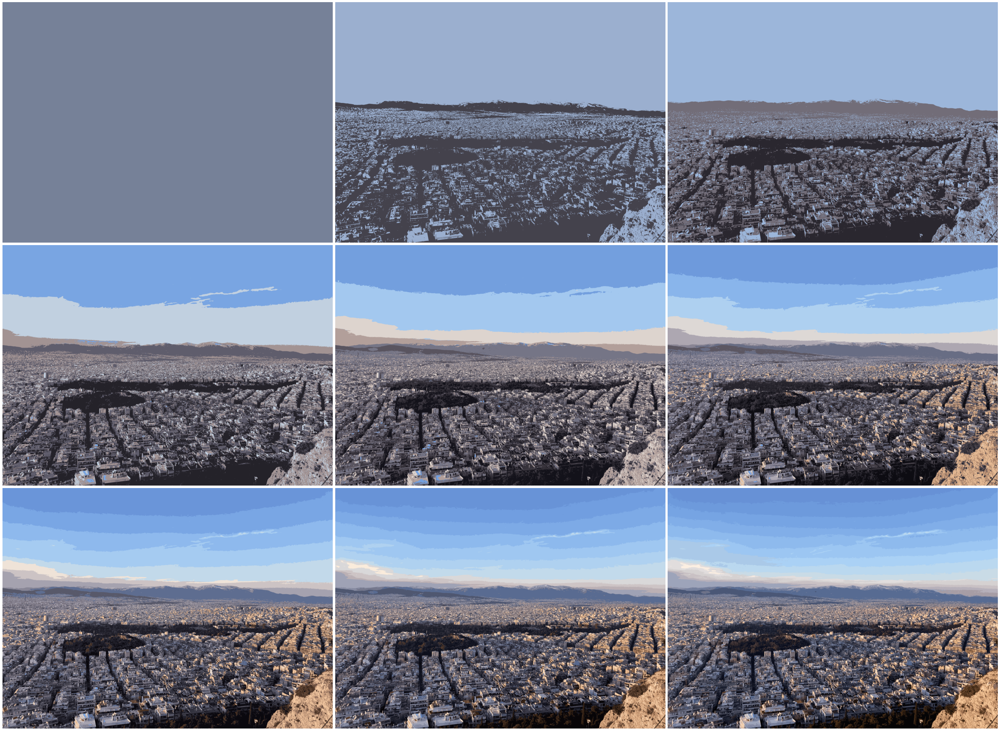

In [105]:
# test the final function
IMAGE_PATH = "city.jpg"
image_kmeans_mossaic(IMAGE_PATH, 
                     width=3, height=3, step=2,
                     progression="fibonacci", 
                     save_image_path="city_output.png"
                    )

### Other way to produce the subplots avoiding aspect='auto'
With gridspec from https://stackoverflow.com/questions/41071947/how-to-remove-the-space-between-subplots-in-matplotlib-pyplot